In [ ]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import tensorflow_datasets as tfds
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow
from tensorflow.keras import backend as K

import json
import numpy as np
from skimage.draw import polygon
import cv2 as cv
import os 
import shutil
import matplotlib
from google.colab import files

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
!unzip gdrive/My\ Drive/ID_card_thesis/midv_2020.zip

Archive:  gdrive/My Drive/ID_card_thesis/midv_2020.zip
   creating: tmask/
   creating: tmask/photo/
   creating: tmask/photo/annotations/
  inflating: tmask/photo/annotations/alb_id.json  
  inflating: tmask/photo/annotations/esp_id.json  
   creating: tmask/photo/images/
   creating: tmask/photo/images/alb_id/
  inflating: tmask/photo/images/alb_id/00.jpg  
  inflating: tmask/photo/images/alb_id/01.jpg  
  inflating: tmask/photo/images/alb_id/02.jpg  
  inflating: tmask/photo/images/alb_id/03.jpg  
  inflating: tmask/photo/images/alb_id/04.jpg  
  inflating: tmask/photo/images/alb_id/05.jpg  
  inflating: tmask/photo/images/alb_id/06.jpg  
  inflating: tmask/photo/images/alb_id/07.jpg  
  inflating: tmask/photo/images/alb_id/08.jpg  
  inflating: tmask/photo/images/alb_id/09.jpg  
  inflating: tmask/photo/images/alb_id/10.jpg  
  inflating: tmask/photo/images/alb_id/11.jpg  
  inflating: tmask/photo/images/alb_id/12.jpg  
  inflating: tmask/photo/images/alb_id/13.jpg  
  inflating: t

In [ ]:
# reads the json file with the annotations of id cards
def read_annotations_file(json_file):
  try:
      with open(json_file, "r") as read_file:
        data = json.load(read_file)
        return data
  except FileNotFoundError:
    print(f"No such file or directory exists: '{json_file}'")
    return None

# retrieves the image name, and the coordinates of id card position in the image
def retrieve_image_attributes(json_file):
    
    # data contains the json data read from the json file
    data = read_annotations_file(json_file)
    
    if(data):
        image_attributes_list = []                            # list to contain attributes of all images in the json file
        image_metadata = data["_via_img_metadata"]           # metadata of image in which the coordinates are present  
        image_id_list = data["_via_image_id_list"]            # names of images in the metadata

        for img in image_id_list:

            file_name = image_metadata[img]['filename']                          # filename to which the ground truth image wil be stored
            regions = image_metadata[img]['regions']
            all_points_x = regions[1]['shape_attributes']['all_points_x']      # all x coordinates  
            all_points_y = regions[1]['shape_attributes']['all_points_y']      # all y coordinates
            image_attributes_list.append((file_name,all_points_x,all_points_y))   

        return image_attributes_list                                             # list of tuples containing (filename, x coordinates and y coordinates) for every image
    else:
        return None

In [ ]:
# creates groud truth mask from all_points_x and all_points_y of four cornres of ID card in the image
def ground_truth(y_len, x_len, row_arr, col_arr, write_file_name):
    img = np.zeros((y_len, x_len), dtype=np.uint8)
    r = np.array(row_arr)
    c = np.array(col_arr)
    rr, cc = polygon(r,c)
    img[rr,cc] = 255
    
    cv.imwrite(write_file_name, img)

In [ ]:
# creates a new directory 
def create_directory(file_path, new_directory):
    path = os.path.join(file_path, new_directory)
    os.mkdir(path)
    
    return path
# creates ground truth mask at the specified path given
def create_mask(file_path, file_name, img_height, img_width, all_points_y, all_points_x):

    write_file_path = os.path.join(file_path, file_name)
    ground_truth(img_height, img_width, all_points_y, all_points_x, write_file_path)

In [ ]:
PHOTO_HEIGHT = 4032                     # height of images in photos folder
PHOTO_WIDTH = 2268                      # width of images in photos folder

SCAN_HEIGHT = 3507                      # height of images in scanned_rotated and scanned_upright folder
SCAN_WIDTH = 2480                       # width of images in  scanned_rotated and scanned_upright folder

PATH_PREFIX = 'tmask'                   # name of the folder containing the dataset

path_suffix = ["annotations/alb_id.json", "annotations/esp_id.json"]
id_class = ["alb_id", "esp_id"]



type_path = ["photo", "scan_rotated", "scan_upright"]

# creates ground truth mask for Albanian and Spanish ID cards in the entire dataset
for fol in type_path:
    mask_dir = create_directory(os.path.join(PATH_PREFIX, fol), "masks")
    for i in range(len(path_suffix)):
        image_attribute_list = retrieve_image_attributes(os.path.join(PATH_PREFIX, fol, path_suffix[i]))
        id_path = create_directory(mask_dir, id_class[i])

        if image_attribute_list:
          for img in image_attribute_list:
              if(fol == "photo"):
                  create_mask(id_path, img[0], PHOTO_HEIGHT, PHOTO_WIDTH, img[2], img[1])
              else:
                  create_mask(id_path, img[0], SCAN_HEIGHT, SCAN_WIDTH, img[2], img[1])
        else:
          print('empty')

# approx 4 minute running time

In [ ]:
def create_final_dataset_folder(final_data_path):
  final_data_folder = final_data_path
  final_images_path = os.path.join(final_data_folder, "images")
  final_masks_path = os.path.join(final_data_folder, "masks")
  os.mkdir(final_data_folder)
  os.mkdir(final_images_path)
  os.mkdir(final_masks_path)

  return (final_images_path, final_masks_path)

In [ ]:
def use_single_type(final_data_path, orig_data_path, img_num):
  final_paths = create_final_dataset_folder(final_data_path)
  final_images_path = final_paths[0] 
  final_masks_path = final_paths[1] 

  orig_images_path = os.path.join(orig_data_path, 'images')
  orig_masks_path = os.path.join(orig_data_path, 'masks')

  final_img_num = img_num

  for cls in id_class:
    tmp_img_path = os.path.join(orig_images_path, cls)
    tmp_msk_path = os.path.join(orig_masks_path, cls)

    max_iter = 0
    if len(os.listdir(tmp_img_path)) == len(os.listdir(tmp_msk_path)):
      max_iter = len(os.listdir(tmp_img_path))

    for i in range(max_iter):
      old_file_name = f"{i:02}"+str(".jpg")
      new_file_name = f"{final_img_num+i:02}"+str(".jpg")

      img_src_path = os.path.join(tmp_img_path, old_file_name)
      img_dst_path = os.path.join(final_images_path, new_file_name)
      shutil.copy(img_src_path, img_dst_path)

      msk_src_path = os.path.join(tmp_msk_path, old_file_name)
      msk_dst_path = os.path.join(final_masks_path, new_file_name)
      shutil.copy(msk_src_path, msk_dst_path)

    final_img_num += 100

In [ ]:
final_data_path = "data"
photos_img_num = 0
use_single_type(final_data_path, "tmask/photo", photos_img_num)

In [ ]:
scan_up_data_path = "scan_up_data"
scan_up_img_num = 200
use_single_type(scan_up_data_path, "tmask/scan_upright", scan_up_img_num)

In [ ]:
scan_rot_data_path = "scan_rot_data"
scan_rot_img_num = 400
use_single_type(scan_rot_data_path, "tmask/scan_rotated", scan_rot_img_num)

In [ ]:
import os
image_names = os.listdir("data/images")
mask_names = os.listdir("data/masks")

In [ ]:
scan_up_img_names = os.listdir("scan_up_data/images/")
scan_up_msk_names = os.listdir("scan_up_data/masks/")

scan_rot_img_names = os.listdir("scan_rot_data/images/")
scan_rot_msk_names = os.listdir("scan_rot_data/masks/")

In [ ]:
image_names.sort()
mask_names.sort()

In [ ]:
scan_up_img_names.sort()
scan_up_msk_names.sort()

scan_rot_img_names.sort()
scan_rot_msk_names.sort()

In [ ]:
for i in range(1,200):
  if(image_names[i] != mask_names[i]):
    print(image_names[i])
    print(mask_names[i])
    print("------------------------")
  

In [ ]:
for i in range(1,200):
  if(scan_up_img_names[i] != scan_up_msk_names[i]):
    print(image_names[i])
    print(mask_names[i])
    print("------------------------")

In [ ]:
for i in range(1,200):
  if(scan_rot_img_names[i] != scan_rot_msk_names[i]):
    print(image_names[i])
    print(mask_names[i])
    print("------------------------")

In [ ]:
print(image_names[81])
print(mask_names[81])

164.jpg
164.jpg


In [ ]:
print(scan_up_img_names[81])
print(scan_up_msk_names[81])

281.jpg
281.jpg


In [ ]:
print(scan_rot_img_names[81])
print(scan_rot_msk_names[81])

481.jpg
481.jpg


In [ ]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(
    image_names, mask_names, test_size=0.2, random_state=42)

x_train, x_val, y_train, y_val = train_test_split(
    x_train, y_train, test_size=0.25, random_state=42)

In [ ]:
print(len(x_train), len(y_train))
print(len(x_val), len(y_val))
print(len(x_test), len(y_test))

120 120
40 40
40 40


In [ ]:
x_scan_up_train, x_scan_up_test, y_scan_up_train, y_scan_up_test = train_test_split(
    scan_up_img_names, scan_up_msk_names, test_size=0.2, random_state=42)

x_scan_up_train, x_scan_up_val, y_scan_up_train, y_scan_up_val = train_test_split(
    x_scan_up_train, y_scan_up_train, test_size=0.62, random_state=42)

In [ ]:
print(len(x_scan_up_train), len(y_scan_up_train))
print(len(x_scan_up_val), len(y_scan_up_val))
print(len(x_scan_up_test), len(y_scan_up_test))

60 60
20 20
20 20


In [ ]:
x_scan_up_val = x_scan_up_val[:20]
y_scan_up_val = y_scan_up_val[:20]

x_scan_up_test = x_scan_up_test[:20]
y_scan_up_test = y_scan_up_test[:20]

In [ ]:
x_scan_rot_train, x_scan_rot_test, y_scan_rot_train, y_scan_rot_test = train_test_split(
    scan_rot_img_names, scan_rot_msk_names, test_size=0.2, random_state=42)

x_scan_rot_train, x_scan_rot_val, y_scan_rot_train, y_scan_rot_val = train_test_split(
    x_scan_rot_train, y_scan_rot_train, test_size=0.62, random_state=42)

In [ ]:
print(len(x_scan_rot_train), len(y_scan_rot_train))
print(len(x_scan_rot_val), len(y_scan_rot_val))
print(len(x_scan_rot_test), len(y_scan_rot_test))

60 60
20 20
20 20


In [ ]:
x_scan_rot_val = x_scan_rot_val[:20]
y_scan_rot_val = y_scan_rot_val[:20]

x_scan_rot_test = x_scan_rot_test[:20]
y_scan_rot_test = y_scan_rot_test[:20]

In [ ]:
# x_train +=  x_scan_up_train + x_scan_rot_train
# y_train +=  y_scan_up_train + y_scan_rot_train
# x_val +=  x_scan_up_val + x_scan_rot_val
# y_val +=  y_scan_up_val + y_scan_rot_val

In [ ]:
print(len(x_train))
print(len(y_train))
print(len(x_val))
print(len(y_val))

160
160
20
20


In [ ]:
def read_images(image_list, image_path):
  temp_image_list = []
  for image in image_list:
    orig_img = cv.imread(os.path.join(image_path, image))
    res_img = cv.resize(orig_img, (256,256), interpolation=cv.INTER_NEAREST)/255
    temp_image_list.append(tf.constant(res_img))
  return temp_image_list

def read_masks(mask_list, mask_path):
  temp_mask_list = []
  for mask in mask_list:
    orig_msk = cv.imread(os.path.join(mask_path, mask),cv.IMREAD_GRAYSCALE)
    res_msk = cv.resize(orig_msk, (256,256), interpolation=cv.INTER_NEAREST)/255
    temp_mask_list.append(tf.constant(np.expand_dims(res_msk,axis=2)))
  return temp_mask_list

In [ ]:
train_images = read_images(x_train, "data/images")
train_masks = read_masks(y_train, "data/masks")
val_images = read_images(x_val, "data/images")
val_masks = read_masks(y_val, "data/masks")
test_images = read_images(x_test, "data/images")
test_masks = read_masks(y_test, "data/masks")

# approx 45s

In [ ]:
print(len(train_images))
print(len(train_masks))
print(len(val_images))
print(len(val_masks))
print(len(test_images))
print(len(test_masks))

120
120
40
40
40
40


In [ ]:
scan_up_train_images = read_images(x_scan_up_train, "scan_up_data/images")
scan_up_train_masks = read_masks(y_scan_up_train, "scan_up_data/masks")
scan_up_val_images = read_images(x_scan_up_val, "scan_up_data/images")
scan_up_val_masks = read_masks(y_scan_up_val, "scan_up_data/masks")
scan_up_test_images = read_images(x_scan_up_test, "scan_up_data/images")
scan_up_test_masks = read_masks(y_scan_up_test, "scan_up_data/masks")



In [ ]:
# for img,msk in zip(scan_up_train_images, scan_up_train_masks):
#   cv2_imshow(np.squeeze(img*255))
#   cv2_imshow(np.squeeze(msk*255))

In [ ]:
# scan_up_test_images = scan_up_test_images[:40]
# scan_up_test_masks = scan_up_test_masks[:40]

In [ ]:
print(len(scan_up_train_images))
print(len(scan_up_train_masks))
print(len(scan_up_val_images))
print(len(scan_up_val_masks))
print(len(scan_up_test_images))
print(len(scan_up_test_masks))

60
60
20
20
20
20


In [ ]:
scan_rot_train_images = read_images(x_scan_rot_train, "scan_rot_data/images")
scan_rot_train_masks = read_masks(y_scan_rot_train, "scan_rot_data/masks")
scan_rot_val_images = read_images(x_scan_rot_val, "scan_rot_data/images")
scan_rot_val_masks = read_masks(y_scan_rot_val, "scan_rot_data/masks")
scan_rot_test_images = read_images(x_scan_rot_test, "scan_rot_data/images")
scan_rot_test_masks = read_masks(y_scan_rot_test, "scan_rot_data/masks")

In [ ]:
# scan_rot_test_images = scan_rot_test_images[:40]
# scan_rot_test_masks = scan_rot_test_masks[:40]

In [ ]:
print(len(scan_rot_train_images))
print(len(scan_rot_train_masks))
print(len(scan_rot_val_images))
print(len(scan_rot_val_masks))
print(len(scan_rot_test_images))
print(len(scan_rot_test_masks))

60
60
20
20
20
20


In [ ]:
# iter = 0
# for img,msk in zip(train_images, train_masks):
#   if iter == 20:
#     break
#   else:
#     cv2_imshow(np.squeeze(img*255))
#     cv2_imshow(np.squeeze(msk*255))
#   iter += 1


In [ ]:
# for img,msk in zip(scan_rot_val_images, scan_rot_val_masks):
#   cv2_imshow(np.squeeze(img*255))
#   cv2_imshow(np.squeeze(msk*255))

In [ ]:
import random

train_images += scan_up_train_images + scan_rot_train_images
train_masks += scan_up_train_masks + scan_rot_train_masks

random.Random(42).shuffle(train_images)
random.Random(42).shuffle(train_masks)


val_images += scan_up_val_images + scan_rot_val_images
val_masks += scan_up_val_masks + scan_rot_val_masks

random.Random(42).shuffle(val_images)
random.Random(42).shuffle(val_masks)


test_images += scan_up_test_images + scan_rot_test_images
test_masks += scan_up_test_masks + scan_rot_test_masks

random.Random(42).shuffle(test_images)
random.Random(42).shuffle(test_masks)


In [ ]:
len(train_images)

240

In [ ]:
len(val_images)

80

In [ ]:
train_dataset = tf.data.Dataset.from_tensor_slices((train_images, train_masks))
val_dataset = tf.data.Dataset.from_tensor_slices((val_images, val_masks))
test_dataset = tf.data.Dataset.from_tensor_slices((test_images, test_masks))

In [ ]:
# scan_up_test_dataset = tf.data.Dataset.from_tensor_slices((scan_up_test_images, scan_up_test_masks))
# scan_rot_test_dataset = tf.data.Dataset.from_tensor_slices((scan_rot_test_images, scan_rot_test_masks))

In [ ]:
BATCH_SIZE = 16
train_batches = train_dataset.batch(BATCH_SIZE).repeat()
train_batches = train_batches.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)
val_batches = val_dataset.batch(BATCH_SIZE).repeat()
val_batches = val_batches.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

In [ ]:
# test_batches = test_dataset.batch(BATCH_SIZE).repeat()
# test_batches = test_batches.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

In [ ]:
test_batches = test_dataset.batch(BATCH_SIZE)

In [ ]:
# scan_up_test_batches =  scan_up_test_dataset.batch(BATCH_SIZE)

In [ ]:
# scan_rot_test_batches =  scan_rot_test_dataset.batch(BATCH_SIZE)

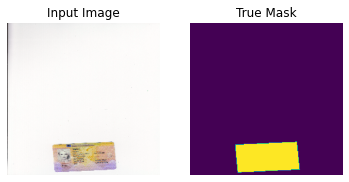

In [ ]:
def display(display_list):
 plt.figure()

 title = ["Input Image", "True Mask", "Predicted Mask"]

 for i in range(len(display_list)):
   plt.subplot(1, len(display_list), i+1)
   plt.title(title[i])
   plt.imshow(tf.keras.utils.array_to_img(display_list[i]))
   plt.axis("off")
 plt.show()

sample_batch = next(iter(train_batches))
random_index = np.random.choice(sample_batch[0].shape[0])
sample_image, sample_mask = sample_batch[0][random_index], sample_batch[1][random_index]
display([sample_image, sample_mask])

In [ ]:
def double_conv_block(x, n_filters):

   # Conv2D then ReLU activation
   x = layers.Conv2D(n_filters, 3, padding = "same", activation = "relu", kernel_initializer = "he_normal")(x)
   # Conv2D then ReLU activation
   x = layers.Conv2D(n_filters, 3, padding = "same", activation = "relu", kernel_initializer = "he_normal")(x)

   return x

In [ ]:
def downsample_block(x, n_filters):
   f = double_conv_block(x, n_filters)
   p = layers.MaxPool2D(2)(f)
   p = layers.Dropout(0.3)(p)

   return f, p

In [ ]:
def upsample_block(x, conv_features, n_filters):
   # upsample
   x = layers.Conv2DTranspose(n_filters, 3, 2, padding="same")(x)
   # concatenate
   x = layers.concatenate([x, conv_features])
   # dropout
   x = layers.Dropout(0.3)(x)
   # Conv2D twice with ReLU activation
   x = double_conv_block(x, n_filters)

   return x

In [ ]:
def build_unet_model():
  # inputs
  inputs = layers.Input(shape=(256,256,3))

  f1, p1 = downsample_block(inputs, 64)
  f2, p2 = downsample_block(p1, 128)
  f3, p3 = downsample_block(p2, 256)

  bottleneck = double_conv_block(p3, 512)

  u6 = upsample_block(bottleneck, f3, 256)
  u7 = upsample_block(u6, f2, 128)
  u8 = upsample_block(u7, f1, 64)

  outputs = layers.Conv2D(1, 1, padding="same",activation='sigmoid')(u8)

  # unet model with Keras Functional API
  unet_model = tf.keras.Model(inputs, outputs, name="U-Net")

  return unet_model

In [ ]:
unet_model = build_unet_model()

In [ ]:
unet_model.compile(optimizer=tf.keras.optimizers.Adam(),
                  loss="binary_crossentropy",
                  metrics=['accuracy'])

In [ ]:
unet_model.summary()

Model: "U-Net"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 256, 256, 64  1792        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 conv2d_1 (Conv2D)              (None, 256, 256, 64  36928       ['conv2d[0][0]']                 
                                )                                                             

In [ ]:
len(train_dataset)

240

In [ ]:
def MyCallback():
  checkpointer = tf.keras.callbacks.ModelCheckpoint(
      filepath='unet.h5', 
      verbose=0, 
      save_best_only=True, 
      save_weights_only=True)
  
  earlystopping = tf.keras.callbacks.EarlyStopping(
    monitor="accuracy",
    patience=10,
    restore_best_weights=True)
  
  callbacks = [checkpointer, earlystopping]
  return callbacks


In [ ]:
NUM_EPOCHS = 80

TRAIN_LENGTH = len(train_dataset)
STEPS_PER_EPOCH = TRAIN_LENGTH // BATCH_SIZE

# VAL_SUBSPLITS = 5
TEST_LENTH = len(val_dataset)
# VALIDATION_STEPS = TEST_LENTH // BATCH_SIZE // VAL_SUBSPLITS
VALIDATION_STEPS = TEST_LENTH // BATCH_SIZE 

model_history = unet_model.fit(train_batches,
                              epochs=NUM_EPOCHS,
                              steps_per_epoch=STEPS_PER_EPOCH,
                              validation_steps=VALIDATION_STEPS,
                              validation_data=val_batches,
                               callbacks=[MyCallback()])

Epoch 1/80
15/15 [==============================] - 22s 471ms/step - loss: 0.3975 - accuracy: 0.8426 - val_loss: 0.2848 - val_accuracy: 0.9104
Epoch 2/80
15/15 [==============================] - 7s 447ms/step - loss: 0.2784 - accuracy: 0.9171 - val_loss: 0.2479 - val_accuracy: 0.9197
Epoch 3/80
15/15 [==============================] - 7s 447ms/step - loss: 0.2426 - accuracy: 0.9233 - val_loss: 0.2114 - val_accuracy: 0.9294
Epoch 4/80
15/15 [==============================] - 7s 441ms/step - loss: 0.2206 - accuracy: 0.9251 - val_loss: 0.2552 - val_accuracy: 0.9257
Epoch 5/80
15/15 [==============================] - 7s 448ms/step - loss: 0.2235 - accuracy: 0.9287 - val_loss: 0.1929 - val_accuracy: 0.9344
Epoch 6/80
15/15 [==============================] - 7s 447ms/step - loss: 0.1859 - accuracy: 0.9317 - val_loss: 0.1724 - val_accuracy: 0.9365
Epoch 7/80
15/15 [==============================] - 7s 441ms/step - loss: 0.1954 - accuracy: 0.9217 - val_loss: 0.1766 - val_accuracy: 0.9334
Epoch

In [ ]:
# pred = unet_model.predict(x=test_batches,
#                           steps=PREDICTION_STEPS, verbose=0)

In [ ]:
# pred.shape

In [ ]:
# scan_up_pred = unet_model.predict(x=scan_up_test_batches,
#                            steps=PREDICTION_STEPS, verbose=0)

In [ ]:
# for i in scan_up_test_batches:
#   print(i)
#   break

In [ ]:
# def pred_single_batch(predictions, test_batch):
#   for batch in test_batch:
#     first_batch = batch
#     break
#   true_images = first_batch[0]
#   true_masks = first_batch[1]

#   curr_iter = 0
#   max_imgs = 20
#   all_images = []
#   # res_path = create_directory('/content/','prediction')
#   for true_img, true_msk, pred_msk in zip(true_images, true_masks, predictions):
#     comparison = []
#     img = np.squeeze(true_img).copy()*255
#     msk = np.squeeze(true_msk).copy()*255
#     msk = np.stack((msk,)*3, axis=-1)
#     res = pred_msk.copy()
#     res = res[:,:,0]
#     res[res >= 0.9] = 255
#     res[res < 0.9] = 0
#     res = np.stack((res,)*3, axis=-1)
#     comparison = np.concatenate((img,msk,res), axis=1)
#     cv2_imshow(comparison)

#     # temp_comparison = comparison.copy()
#     # temp_comparison = temp_comparison.astype(int)
#     # temp_comparison = np.uint8(temp_comparison)

#     # img_write = os.path.join(res_path,f'{curr_iter}.png')
#     # matplotlib.image.imsave(img_write, temp_comparison)
#     # files.download(img_write)
#     curr_iter += 1
#     if curr_iter == 20:
#       break

In [ ]:
def calculate_mean_iou_vales(ground_truth, prediction_result):
  mean_true = ground_truth.copy()
  mean_true[mean_true > 0] = 1

  mean_pred = prediction_result.copy()
  mean_pred[mean_pred > 0] = 1

  m = tf.keras.metrics.MeanIoU(num_classes=2)
  m.update_state(mean_true, mean_pred)
  return m.result().numpy()

In [ ]:
def save_image(temp_image, image_path, image_name):
  temp_ = temp_image.copy()
  temp_ = temp_.astype(int)
  temp_ = np.uint8(temp_)

  img_write = os.path.join(image_path,f'{image_name}.png')
  matplotlib.image.imsave(img_write, temp_)

In [ ]:
import matplotlib
from google.colab import files

def pred_masks(predict_dataset, predict_batch, is_card_threshold_val, mean_iou_threshold_val, is_full_batches):
  
  predict_length = len(predict_dataset)
  predict_steps = predict_length // BATCH_SIZE  

  ground_truth_and_predictions= []

  curr_iter = 0
  res_path = create_directory('/content/','prediction')
  res_images_path = create_directory('/content/prediction/','images')
  res_masks_path = create_directory('/content/prediction/','masks')
  res_predictions_path = create_directory('/content/prediction/','pred')
    
 
  for batch in predict_batch:
    predictions = unet_model.predict(x=batch[0],
                          steps=predict_steps, verbose=0)
    first_batch = batch
    
    true_images = first_batch[0]
    true_masks = first_batch[1]

    all_images = []
    
    for true_img, true_msk, pred_msk in zip(true_images, true_masks, predictions):
      comparison = []
      img = np.squeeze(true_img).copy()*255
      msk = np.squeeze(true_msk).copy()*255
      
      res = pred_msk.copy()
      res = res[:,:,0]
      res[res >= is_card_threshold_val] = 255
      res[res < is_card_threshold_val] = 0

      
      ground_truth_and_predictions.append((msk.copy(), res.copy()))
      curr_mean_iou_val = calculate_mean_iou_vales(msk, res)

      msk = np.stack((msk,)*3, axis=-1)
      res = np.stack((res,)*3, axis=-1)

      comparison = np.concatenate((img,msk,res), axis=1)
      print(curr_mean_iou_val)
      cv2_imshow(comparison)
      print('------------------------------------------------------------------')

      if curr_mean_iou_val >= mean_iou_threshold_val and curr_mean_iou_val < 0.99:
        
        save_image(img, res_images_path, curr_iter)
        save_image(msk, res_masks_path, curr_iter)
        save_image(res, res_predictions_path, curr_iter)

      # files.download(img_write)

      curr_iter += 1
    if not is_full_batches:
      break

  return ground_truth_and_predictions

In [ ]:
print("Evaluate on test data")
results = unet_model.evaluate(test_batches)
print("test loss, test acc:", results)

Evaluate on test data
5/5 [==============================] - 1s 136ms/step - loss: 0.0242 - accuracy: 0.9949
test loss, test acc: [0.024213947355747223, 0.9948638677597046]


0.9967399


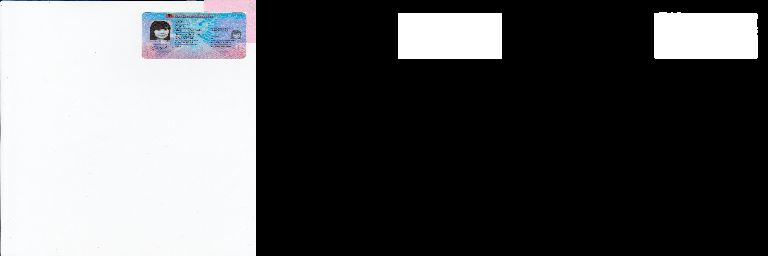

------------------------------------------------------------------
0.98057634


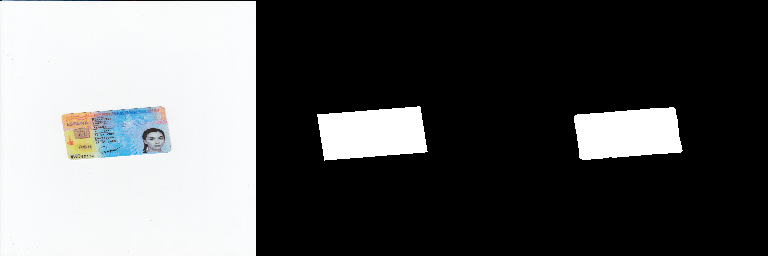

------------------------------------------------------------------
0.95149636


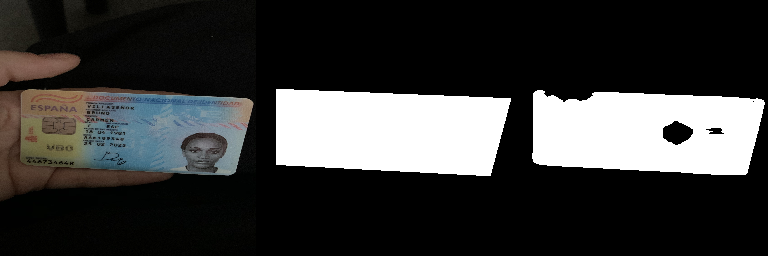

------------------------------------------------------------------
0.99334836


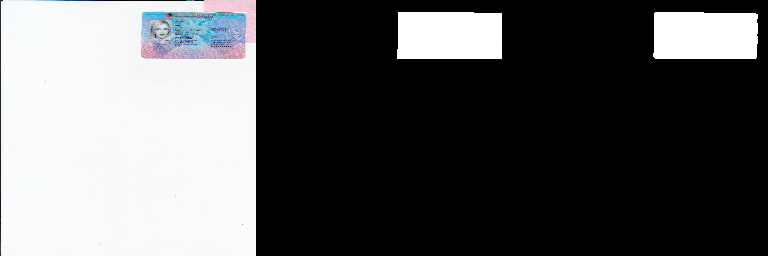

------------------------------------------------------------------
0.97976935


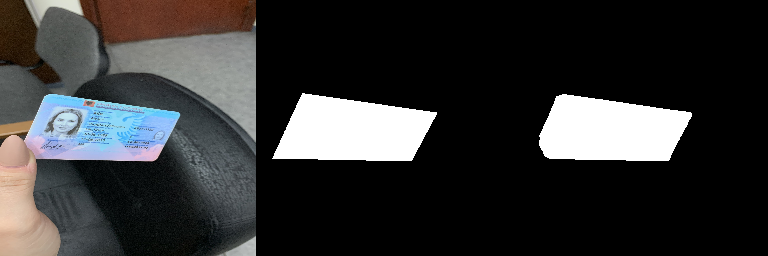

------------------------------------------------------------------
0.9845537


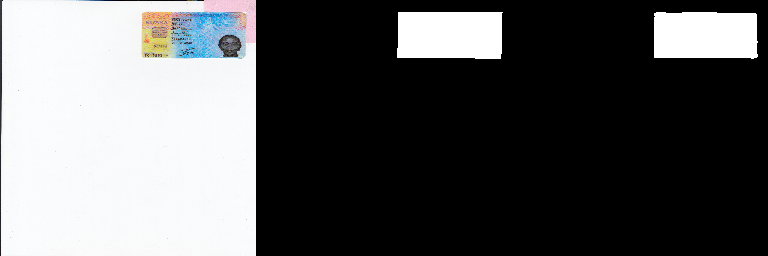

------------------------------------------------------------------
0.98270965


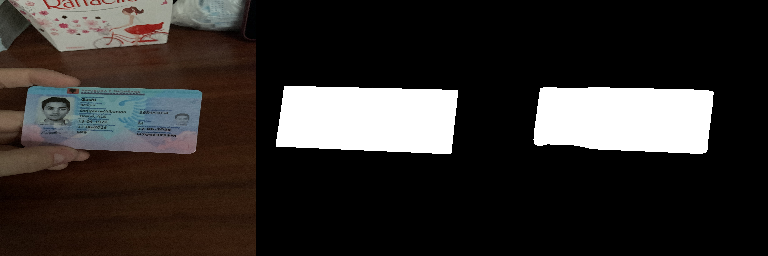

------------------------------------------------------------------
0.99218965


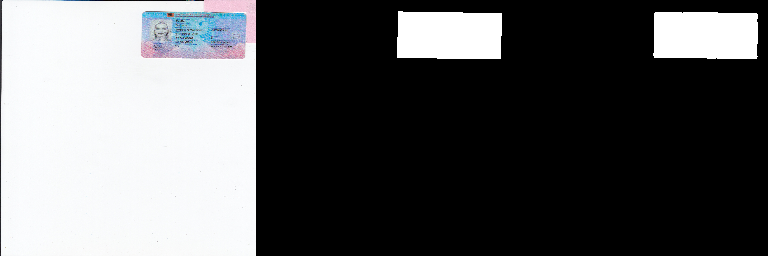

------------------------------------------------------------------
0.9864595


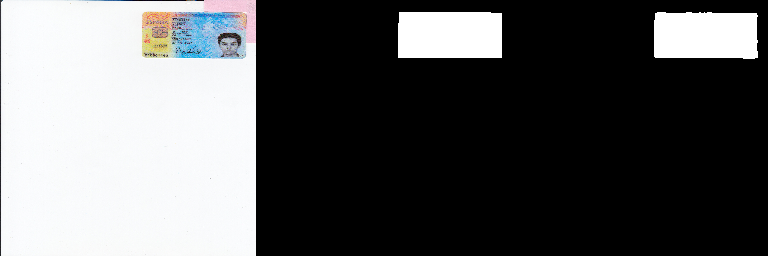

------------------------------------------------------------------
0.9814856


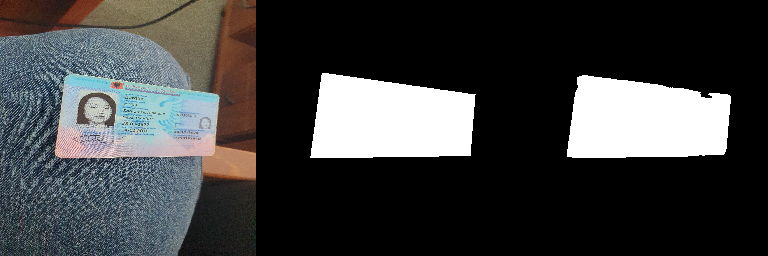

------------------------------------------------------------------
0.9620288


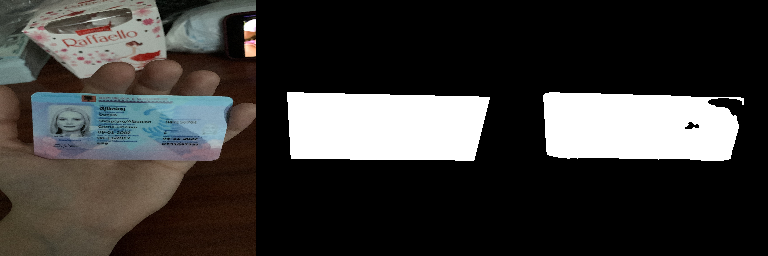

------------------------------------------------------------------
0.97918683


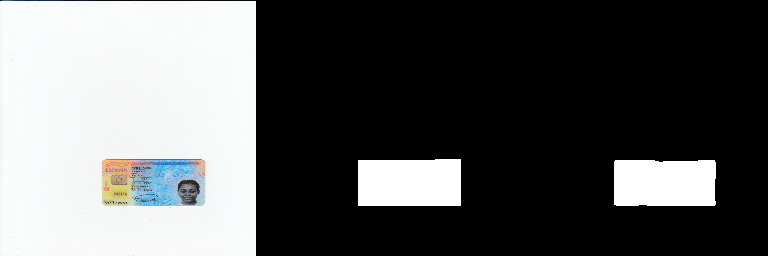

------------------------------------------------------------------
0.99019825


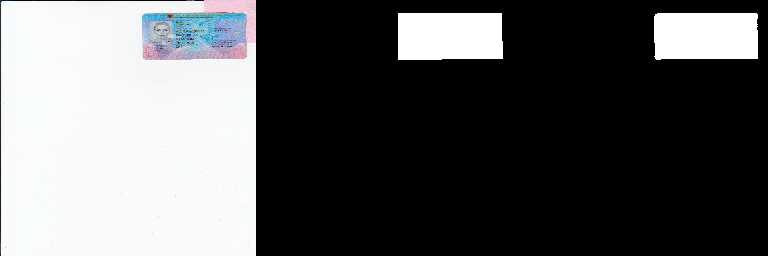

------------------------------------------------------------------
0.9843439


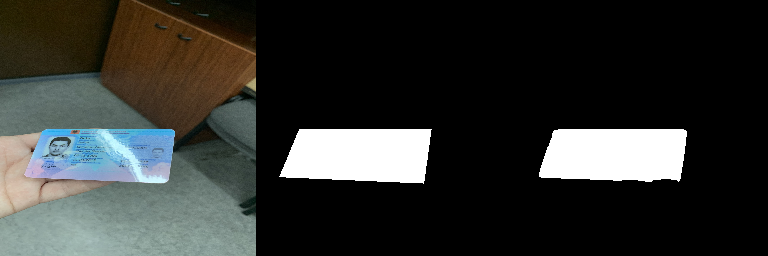

------------------------------------------------------------------
0.9936316


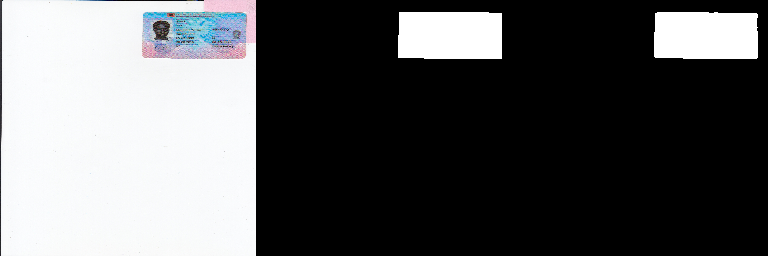

------------------------------------------------------------------
0.9782131


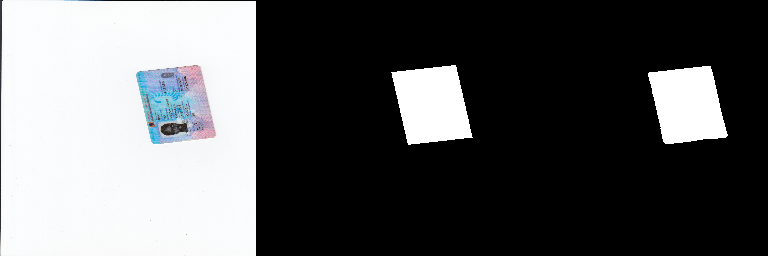

------------------------------------------------------------------
0.924451


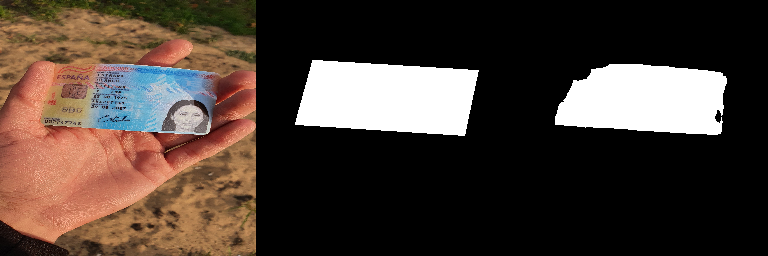

------------------------------------------------------------------
0.9940863


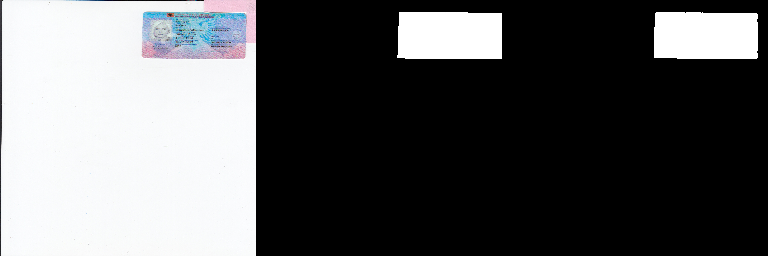

------------------------------------------------------------------
0.98493


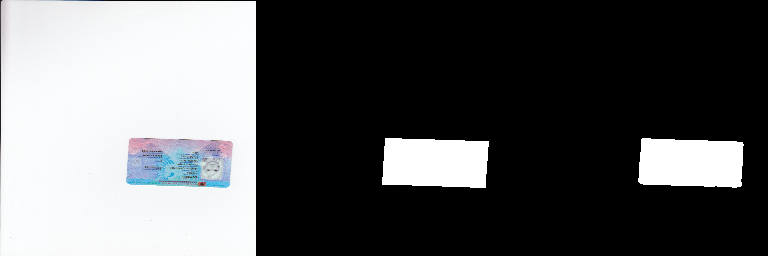

------------------------------------------------------------------
0.989326


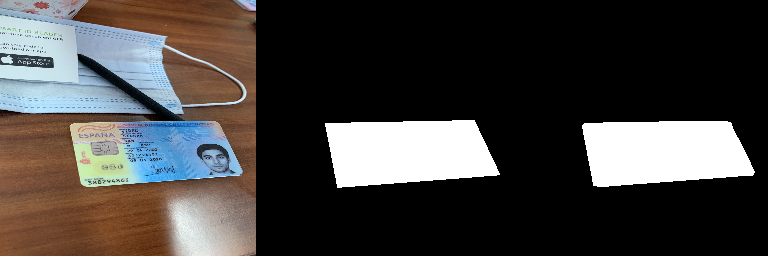

------------------------------------------------------------------
0.9797004


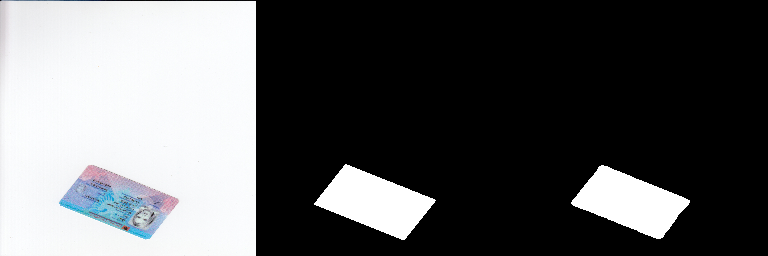

------------------------------------------------------------------
0.9955503


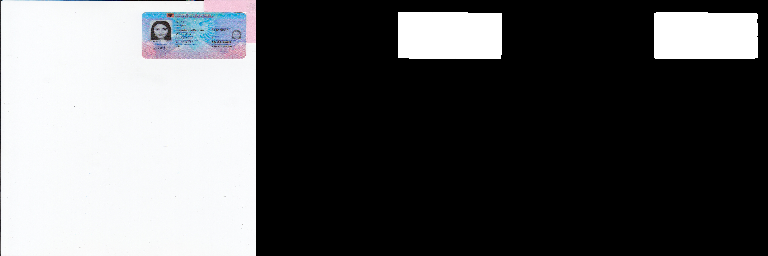

------------------------------------------------------------------
0.9390589


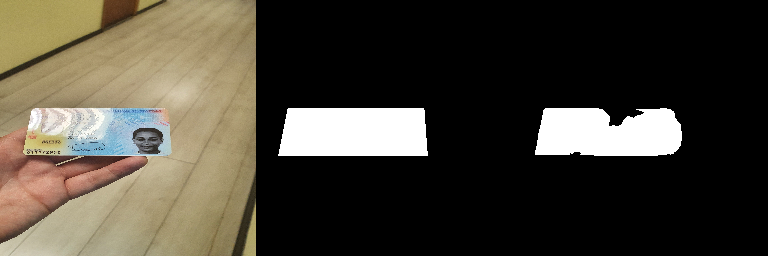

------------------------------------------------------------------
0.9784142


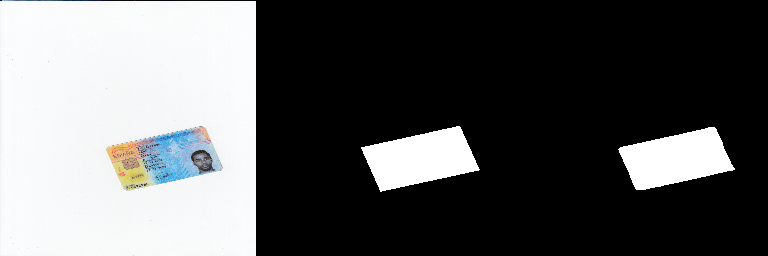

------------------------------------------------------------------
0.9932493


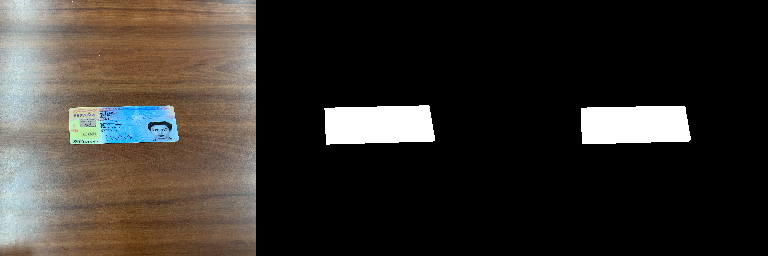

------------------------------------------------------------------
0.97256994


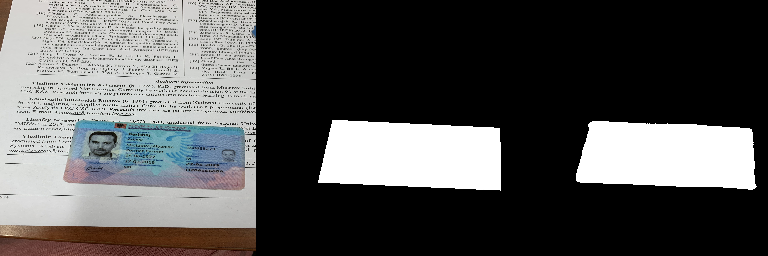

------------------------------------------------------------------
0.99031055


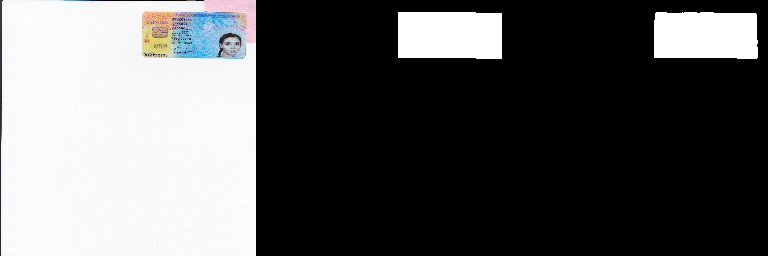

------------------------------------------------------------------
0.9919374


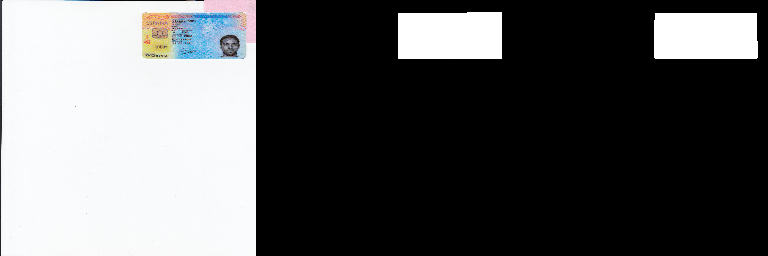

------------------------------------------------------------------
0.98994195


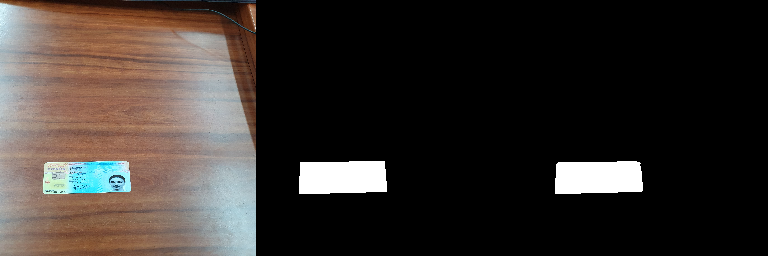

------------------------------------------------------------------
0.9778752


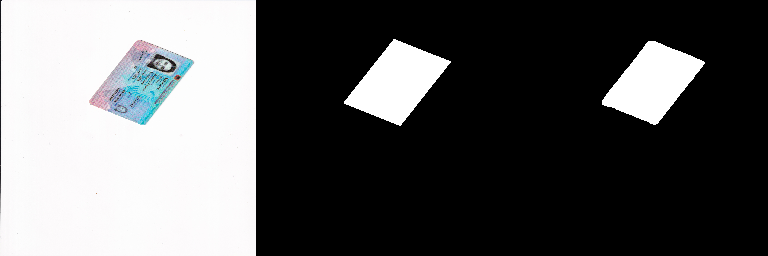

------------------------------------------------------------------
0.98694086


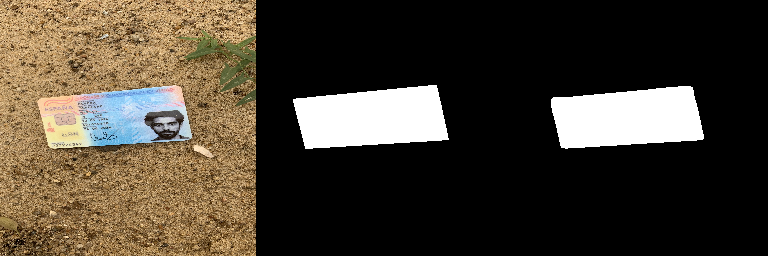

------------------------------------------------------------------
0.9880284


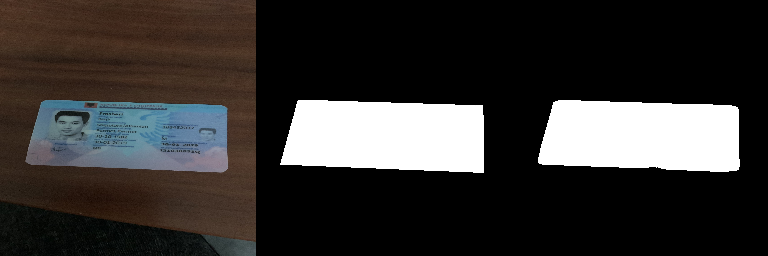

------------------------------------------------------------------
0.98188525


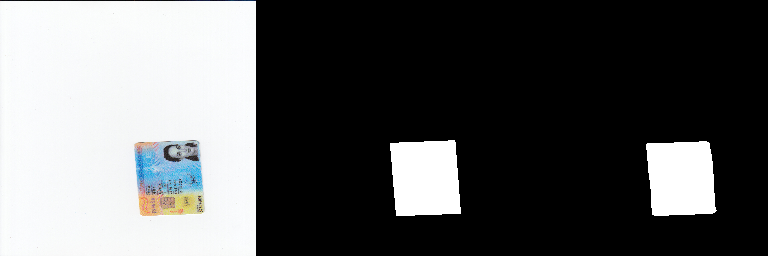

------------------------------------------------------------------
0.9514674


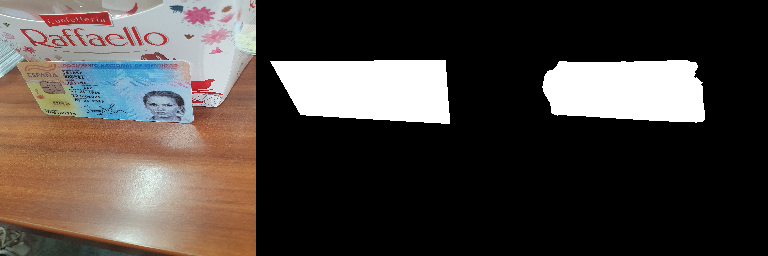

------------------------------------------------------------------
0.9620856


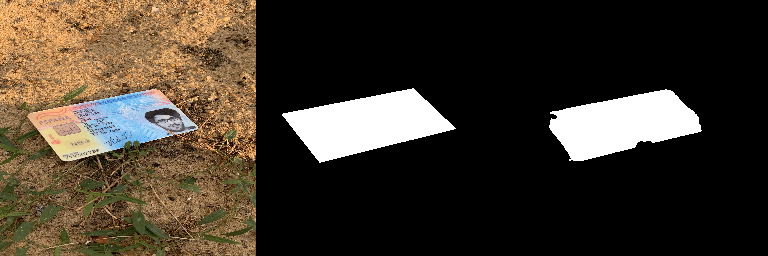

------------------------------------------------------------------
0.9688846


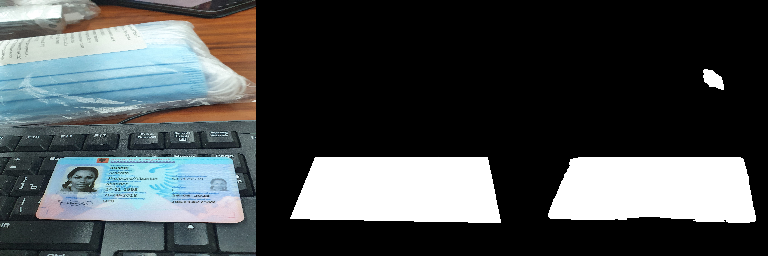

------------------------------------------------------------------
0.9885944


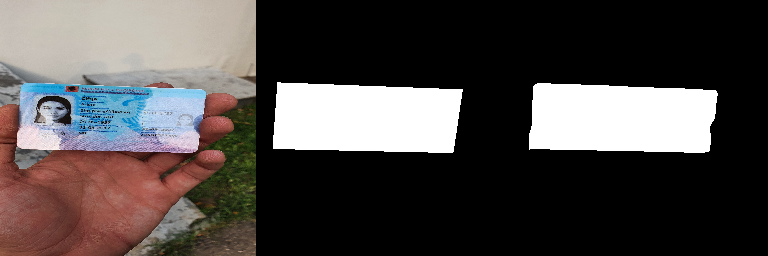

------------------------------------------------------------------
0.9968922


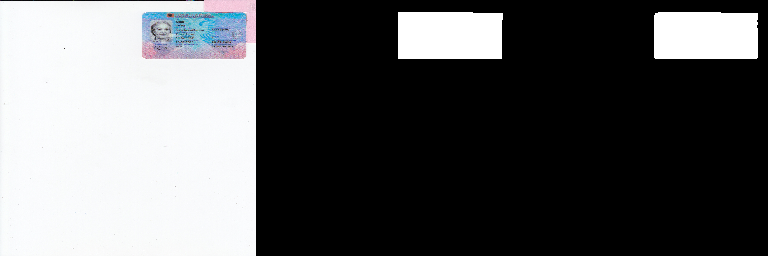

------------------------------------------------------------------
0.96414447


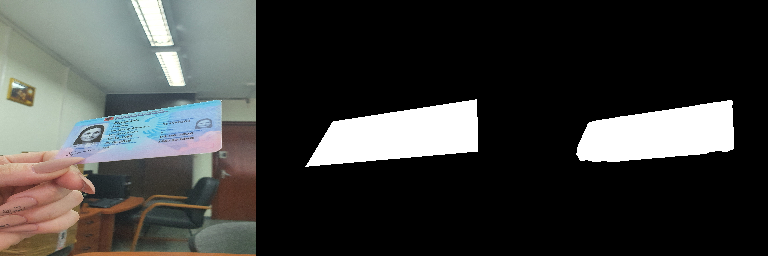

------------------------------------------------------------------
0.72868574


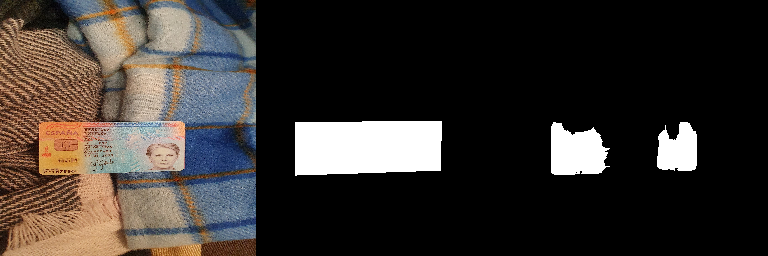

------------------------------------------------------------------
0.942001


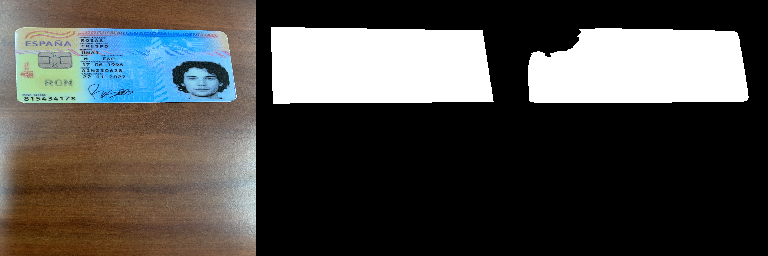

------------------------------------------------------------------
0.97478783


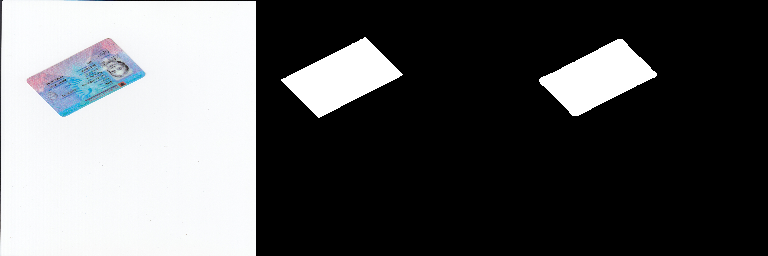

------------------------------------------------------------------
0.98211694


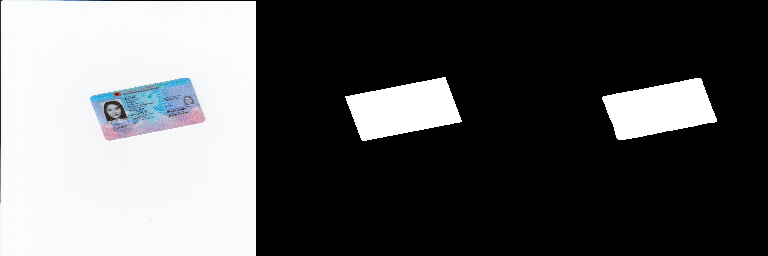

------------------------------------------------------------------
0.9701349


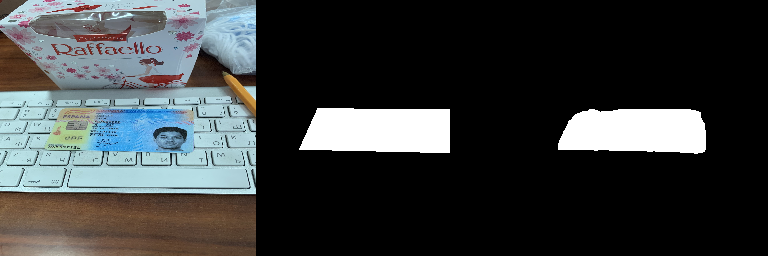

------------------------------------------------------------------
0.9819608


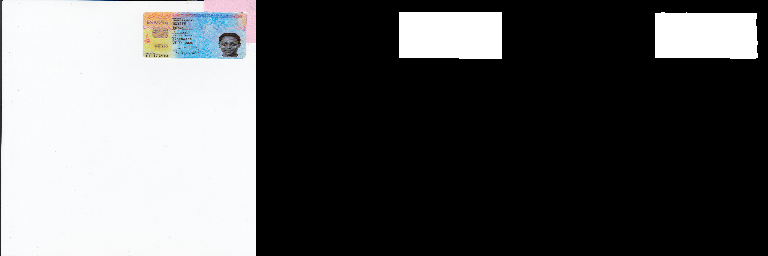

------------------------------------------------------------------
0.95252055


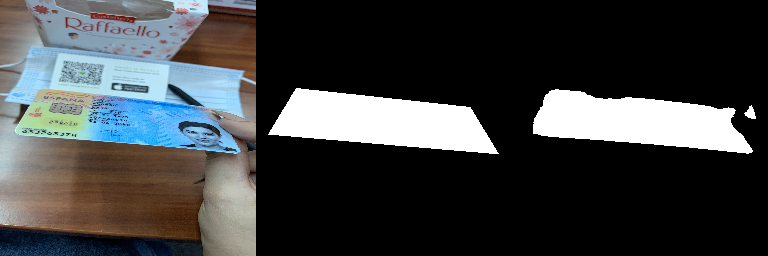

------------------------------------------------------------------
0.97633016


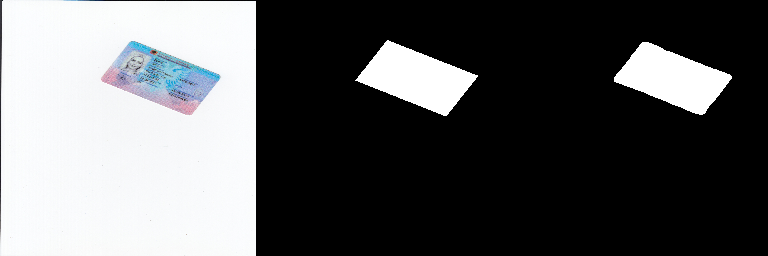

------------------------------------------------------------------
0.99220896


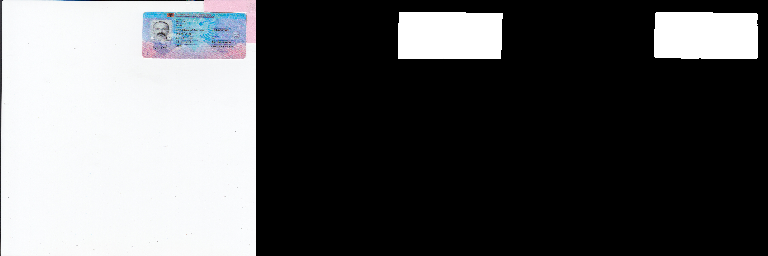

------------------------------------------------------------------
0.98593986


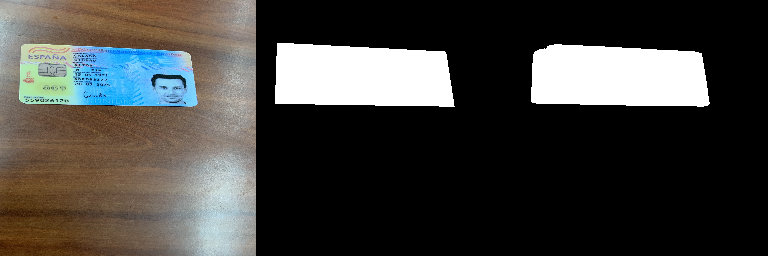

------------------------------------------------------------------
0.98745793


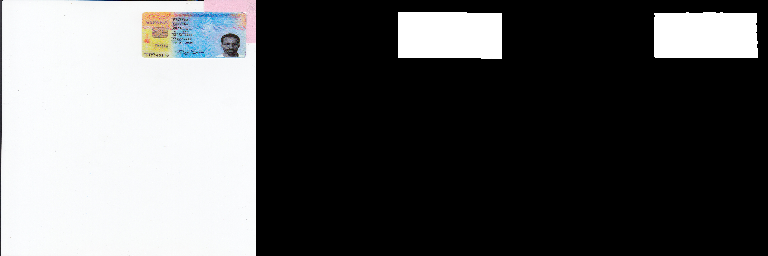

------------------------------------------------------------------
0.90027577


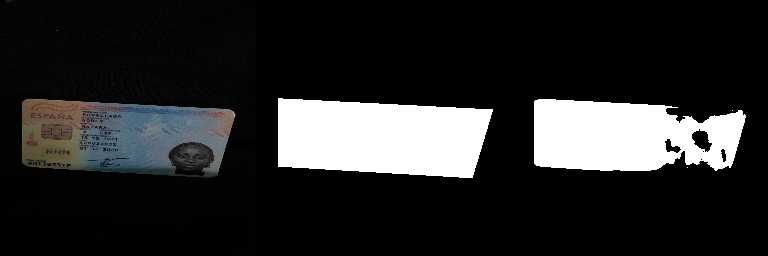

------------------------------------------------------------------
0.9822717


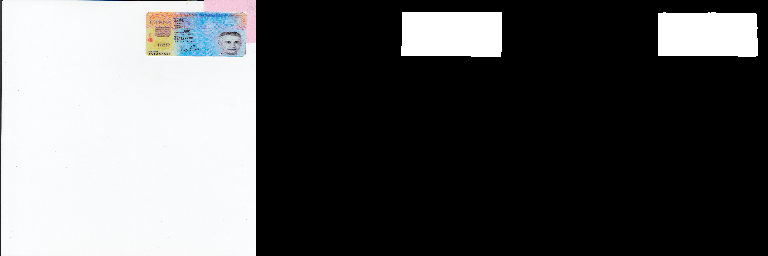

------------------------------------------------------------------
0.9791628


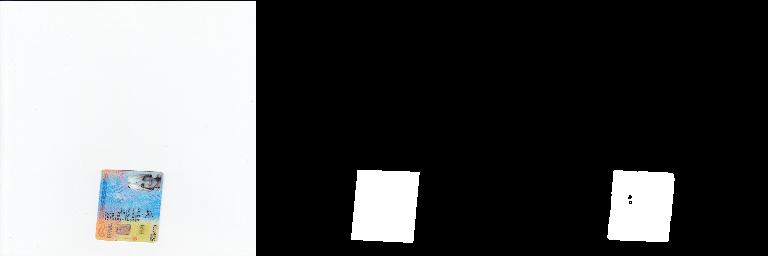

------------------------------------------------------------------
0.8520209


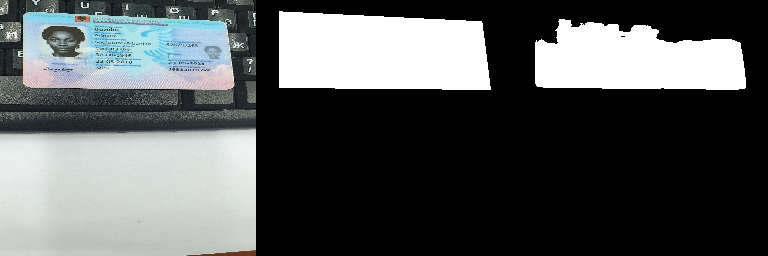

------------------------------------------------------------------
0.97394335


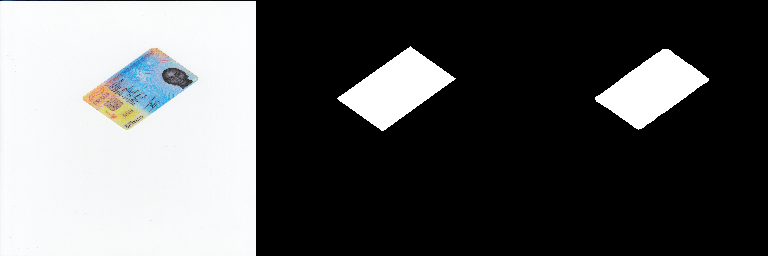

------------------------------------------------------------------
0.97778594


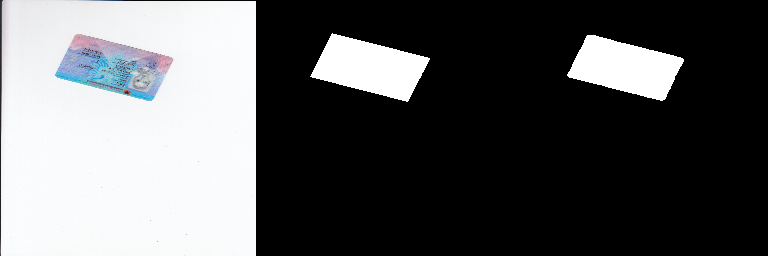

------------------------------------------------------------------
0.8291174


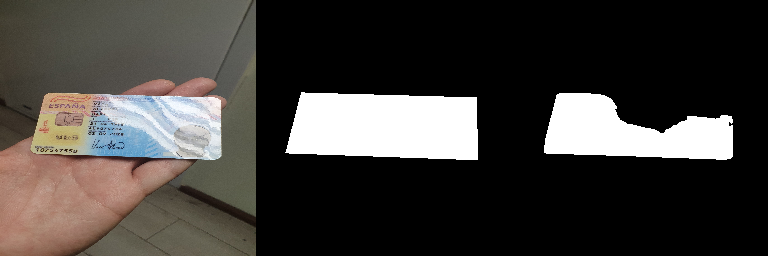

------------------------------------------------------------------
0.99569815


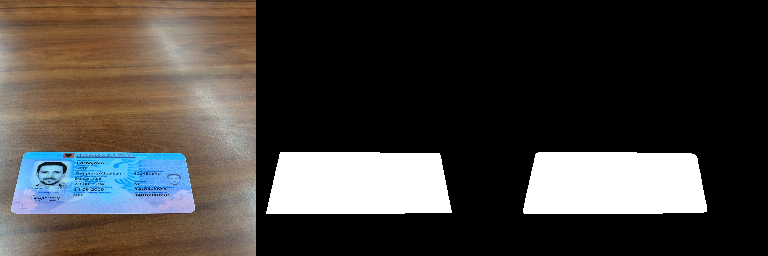

------------------------------------------------------------------
0.98793316


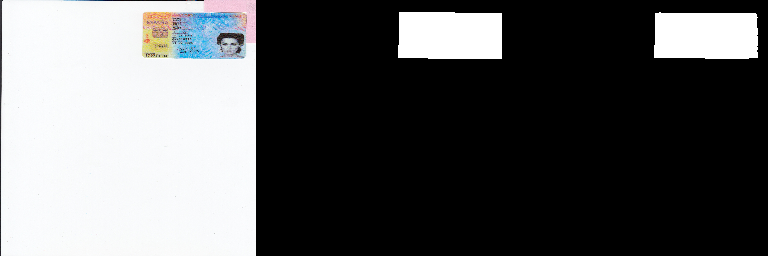

------------------------------------------------------------------
0.9890562


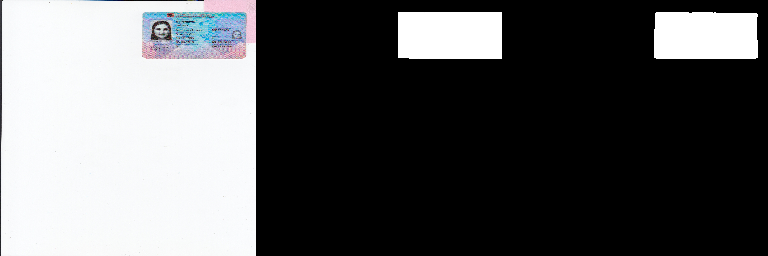

------------------------------------------------------------------
0.991045


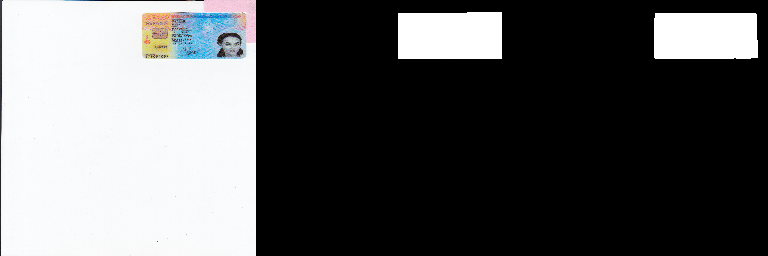

------------------------------------------------------------------
0.9898879


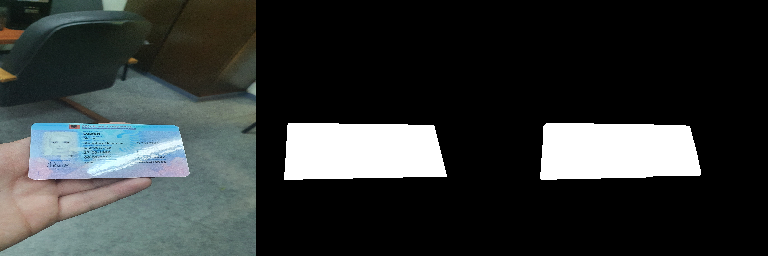

------------------------------------------------------------------
0.97973406


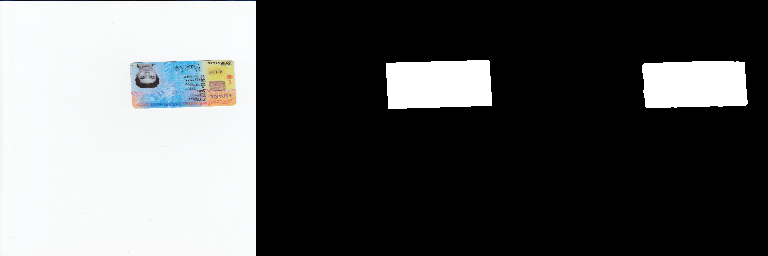

------------------------------------------------------------------
0.9744686


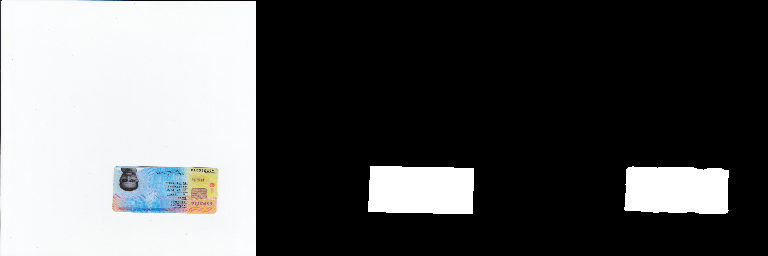

------------------------------------------------------------------
0.9739187


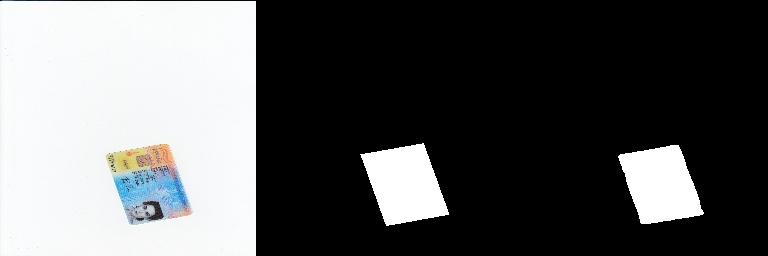

------------------------------------------------------------------
0.9757297


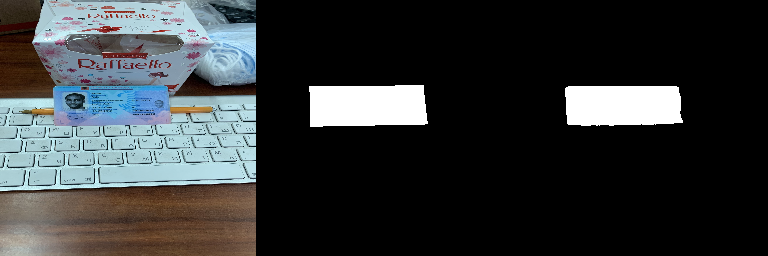

------------------------------------------------------------------
0.993436


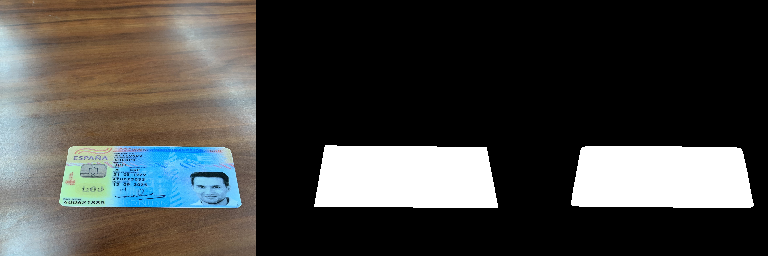

------------------------------------------------------------------
0.9771427


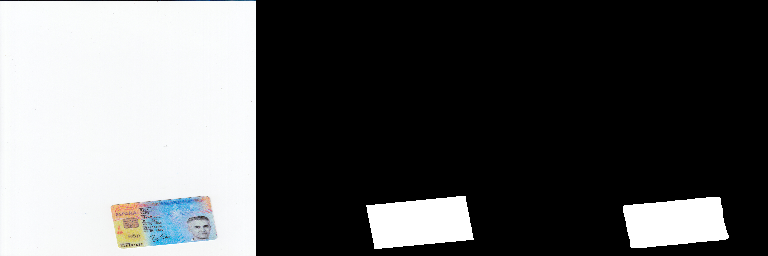

------------------------------------------------------------------
0.9786055


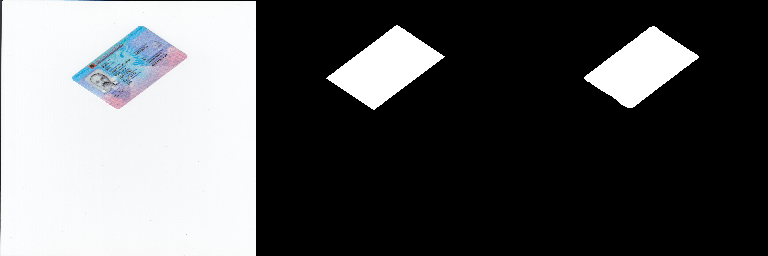

------------------------------------------------------------------
0.9778255


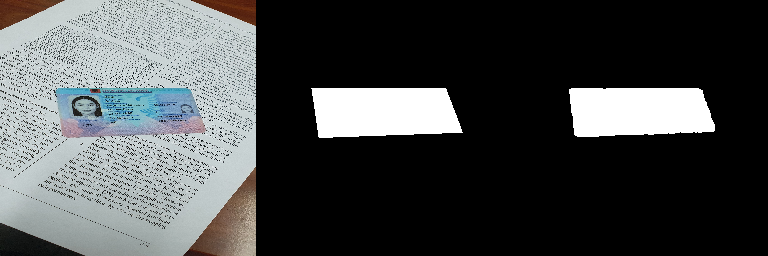

------------------------------------------------------------------
0.98193634


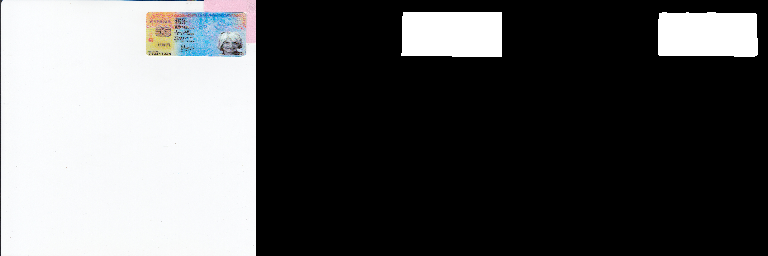

------------------------------------------------------------------
0.98296905


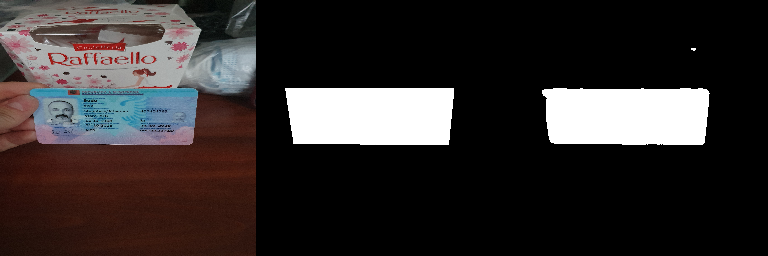

------------------------------------------------------------------
0.97825825


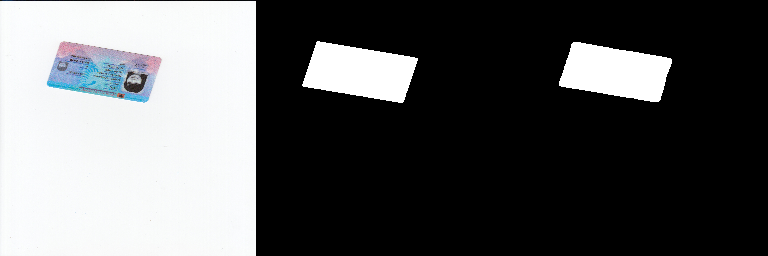

------------------------------------------------------------------
0.85253334


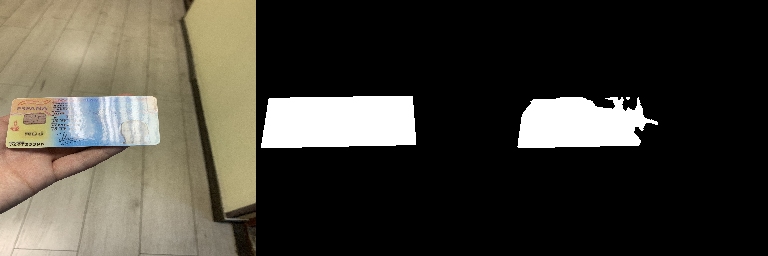

------------------------------------------------------------------
0.9927094


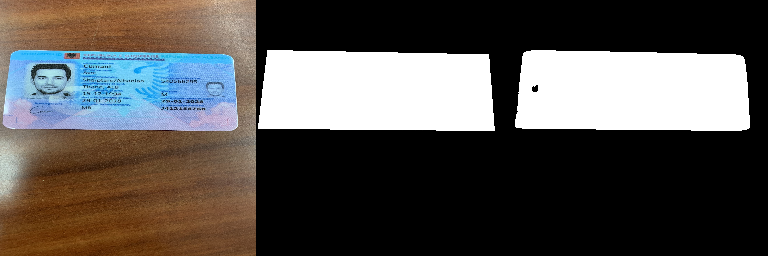

------------------------------------------------------------------
0.9811042


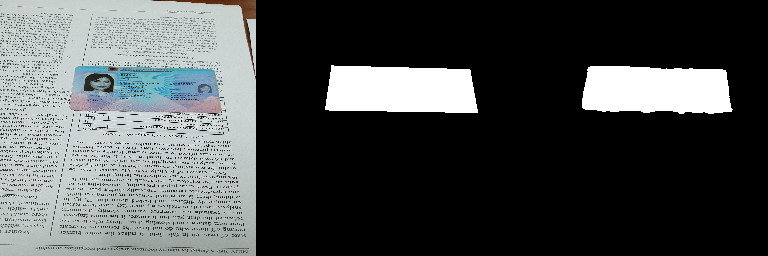

------------------------------------------------------------------
0.96550584


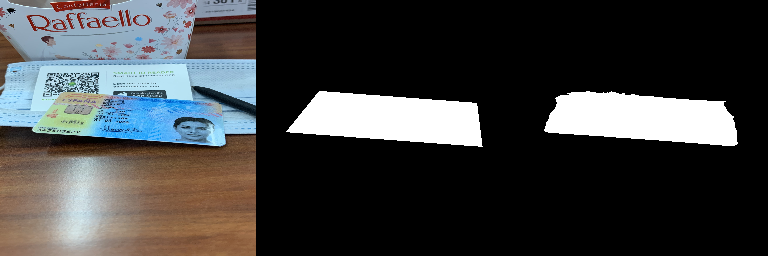

------------------------------------------------------------------
0.98916125


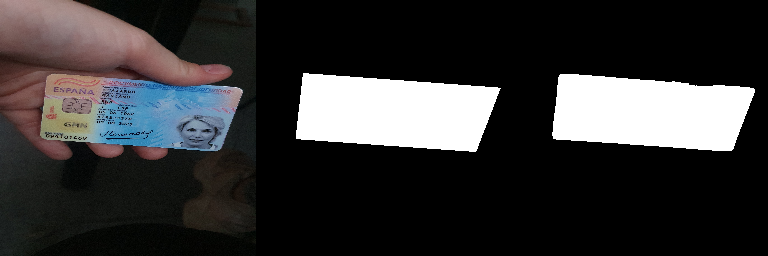

------------------------------------------------------------------
0.9969294


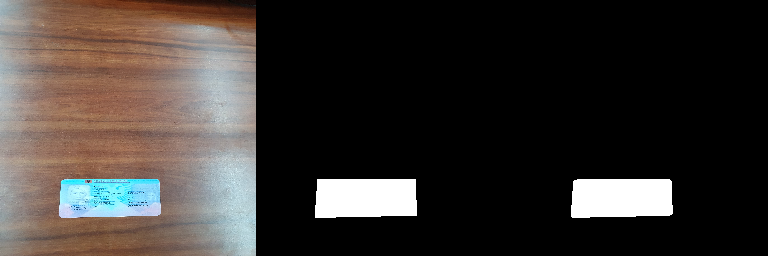

------------------------------------------------------------------
0.9915824


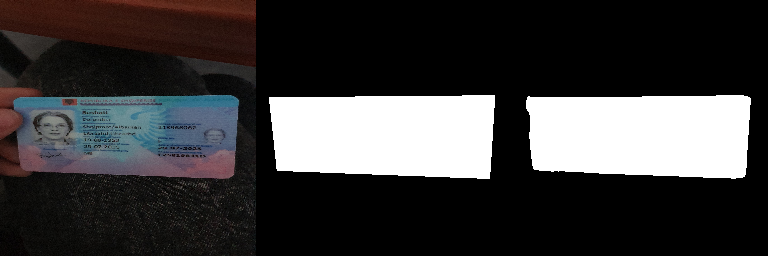

------------------------------------------------------------------


In [ ]:
# max training accuracy: 0.9980
# prediction accuracy: 0.9949
# prediction loss: 0.0242
# 60 scanned upright and 60 scanned rotated image for training
is_card_threshold_val = 0.9
mean_iou_threshold_val = 0.95
ground_truth_and_predictions = pred_masks(test_dataset, test_batches, is_card_threshold_val, mean_iou_threshold_val, True)

In [ ]:
print("Evaluate on test data")
results = unet_model.evaluate(test_batches)
print("test loss, test acc:", results)

Evaluate on test data
4/4 [==============================] - 2s 483ms/step - loss: 0.0063 - accuracy: 0.9978
test loss, test acc: [0.006265953183174133, 0.9978253841400146]


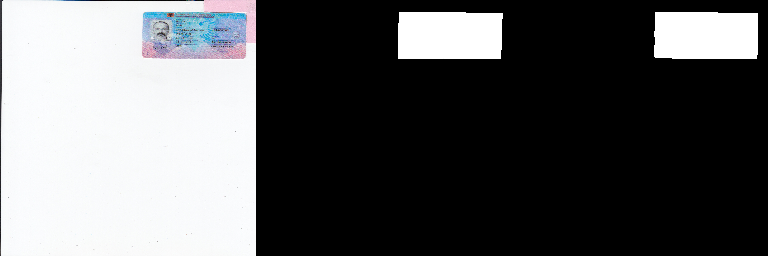

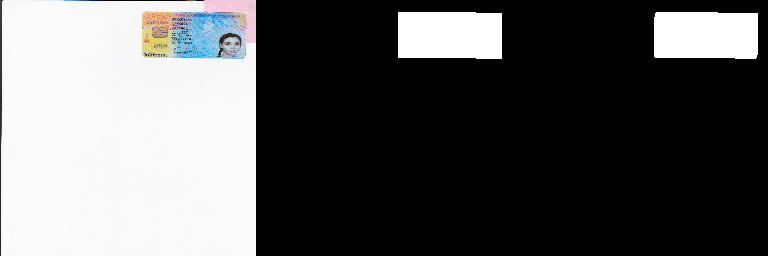

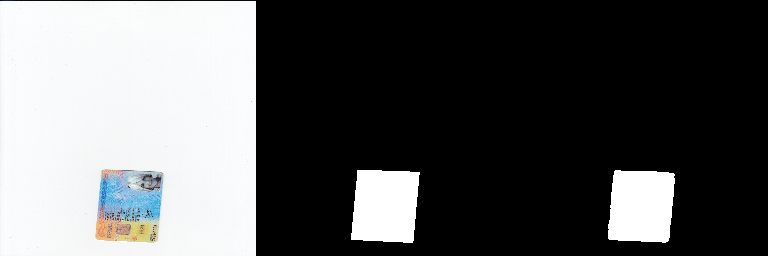

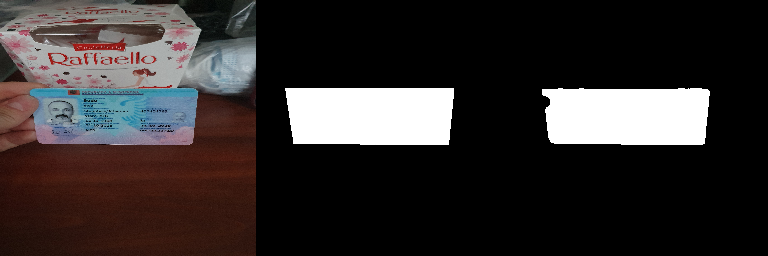

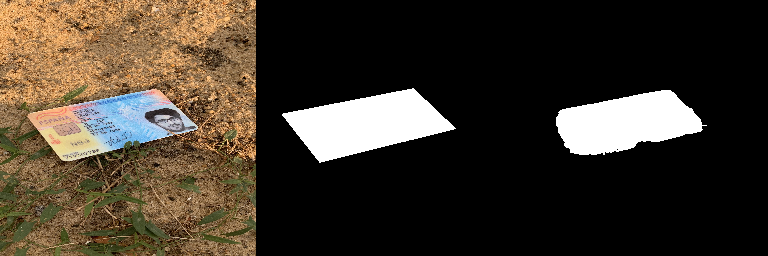

...

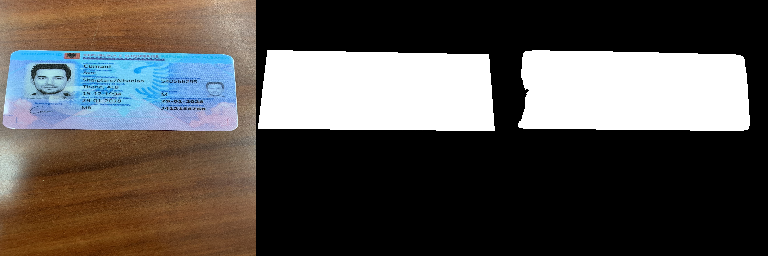

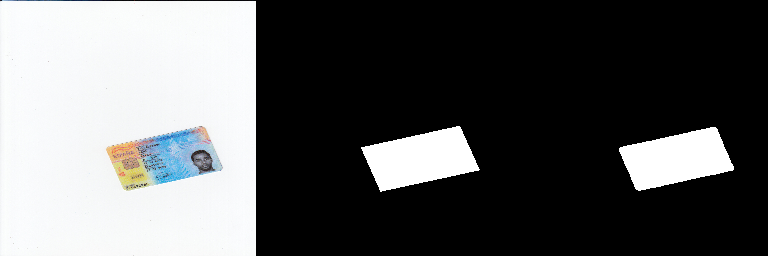

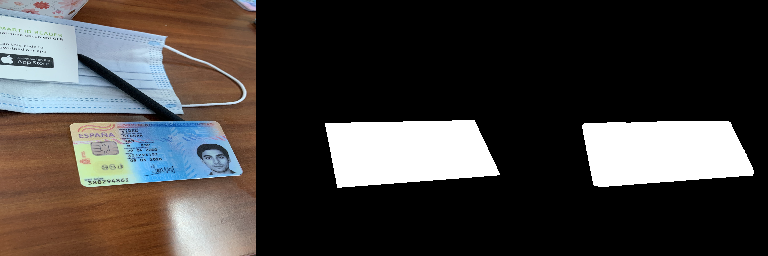

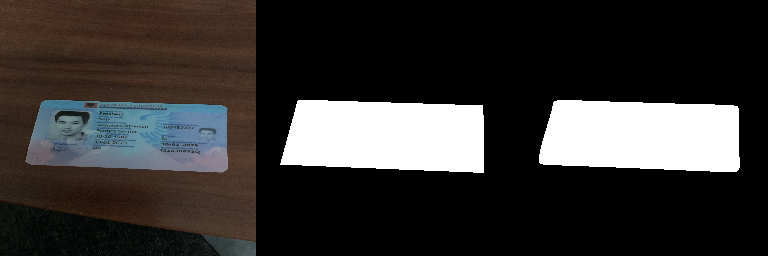

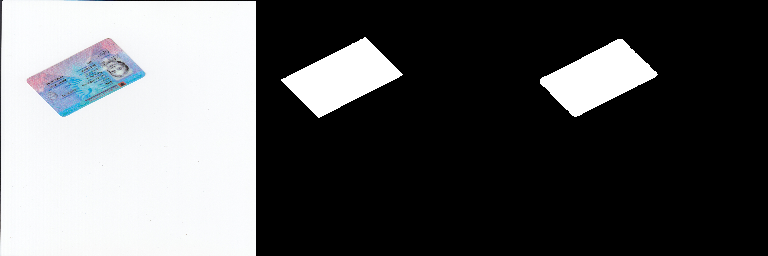

In [ ]:
# max training accuracy: 0.9981
# prediction accuracy: 0.9978
# prediction loss: 0.0063
# 160 scanned upright and 160 scanned rotated image for training
threshold_val = 0.9
ground_truth_and_predictions = pred_masks(test_dataset, test_batches, threshold_val, True)

In [ ]:
mean_iou_values = []
for tup in ground_truth_and_predictions:
  mean_true = tup[0].copy()
  mean_true[mean_true > 0] = 1

  mean_pred = tup[1].copy()
  mean_pred[mean_pred > 0] = 1

  m = tf.keras.metrics.MeanIoU(num_classes=2)
  m.update_state(mean_true, mean_pred)
  mean_iou_values.append(m.result().numpy())

In [ ]:
np.histogram(mean_iou_values)

(array([  1,   0,   0,   0,   0,   0,   0,   3,   7, 109]),
 array([0.7027728 , 0.7321383 , 0.7615037 , 0.7908692 , 0.8202346 ,
        0.8496001 , 0.87896556, 0.908331  , 0.93769646, 0.9670619 ,
        0.99642736], dtype=float32))

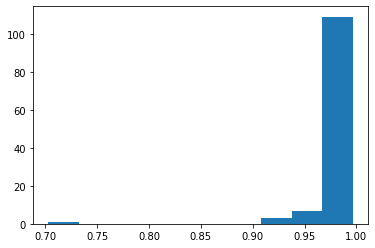

In [ ]:
from matplotlib import pyplot as plt 

plt.hist(mean_iou_values)
plt.show()

In [ ]:
np.histogram(mean_iou_values)

(array([  1,   0,   0,   0,   0,   0,   0,   3,   7, 109]),
 array([0.7027728 , 0.7321383 , 0.7615037 , 0.7908692 , 0.8202346 ,
        0.8496001 , 0.87896556, 0.908331  , 0.93769646, 0.9670619 ,
        0.99642736], dtype=float32))

In [ ]:
np.histogram(mean_iou_values)

(array([ 1,  0,  0,  1,  2,  0,  1,  3,  8, 64]),
 array([0.72868574, 0.7555101 , 0.78233445, 0.80915886, 0.8359832 ,
        0.8628076 , 0.8896319 , 0.9164563 , 0.9432807 , 0.97010505,
        0.9969294 ], dtype=float32))

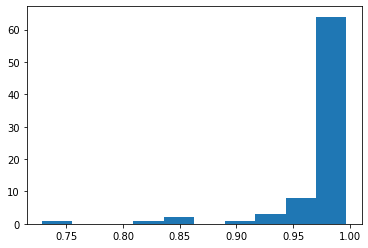

In [ ]:
from matplotlib import pyplot as plt 

plt.hist(mean_iou_values)
plt.show()

In [ ]:
!zip -r /content/prediction.zip /content/prediction

  adding: content/prediction/ (stored 0%)
  adding: content/prediction/masks/ (stored 0%)
  adding: content/prediction/masks/38.png (deflated 35%)
  adding: content/prediction/masks/1.png (deflated 42%)
  adding: content/prediction/masks/19.png (deflated 34%)
  adding: content/prediction/masks/31.png (deflated 38%)
  adding: content/prediction/masks/41.png (deflated 27%)
  adding: content/prediction/masks/9.png (deflated 34%)
  adding: content/prediction/masks/36.png (deflated 42%)
  adding: content/prediction/masks/77.png (deflated 32%)
  adding: content/prediction/masks/72.png (deflated 35%)
  adding: content/prediction/masks/28.png (deflated 60%)
  adding: content/prediction/masks/64.png (deflated 32%)
  adding: content/prediction/masks/52.png (deflated 49%)
  adding: content/prediction/masks/54.png (deflated 27%)
  adding: content/prediction/masks/18.png (deflated 53%)
  adding: content/prediction/masks/4.png (deflated 34%)
  adding: content/prediction/masks/44.png (deflated 77%)
 

In [ ]:
from google.colab import files
files.download("/content/prediction.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
print("Evaluate on test data")
results = unet_model.evaluate(test_batches)
print("test loss, test acc:", results)

Evaluate on test data
4/4 [==============================] - 1s 126ms/step - loss: 0.0039 - accuracy: 0.9980
test loss, test acc: [0.00391724705696106, 0.9980275630950928]


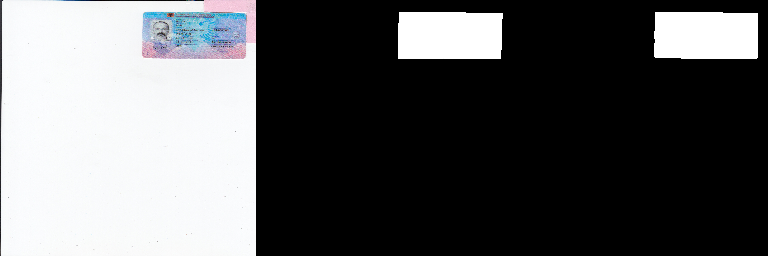

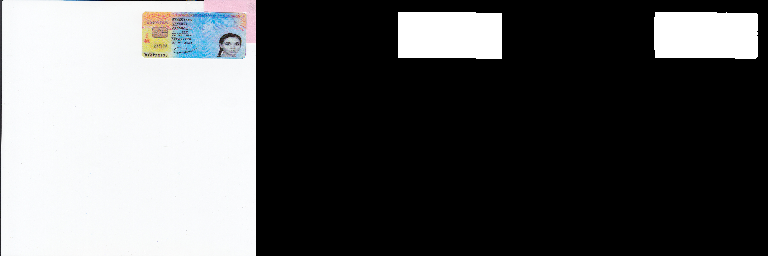

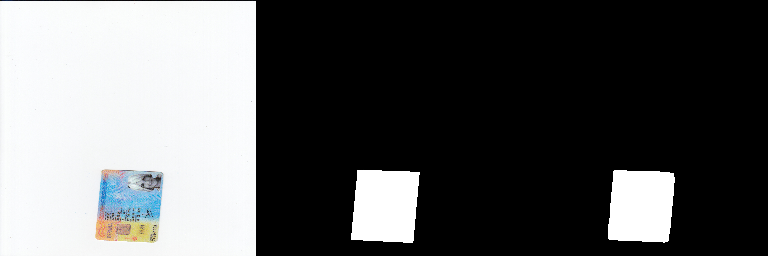

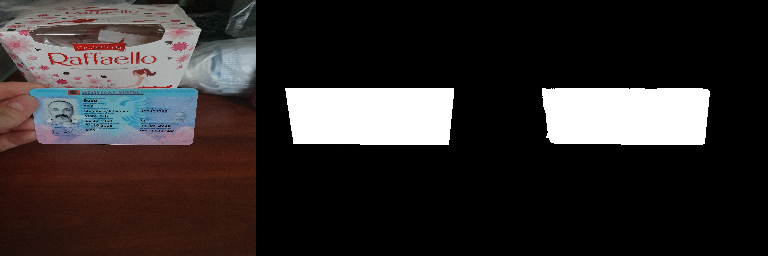

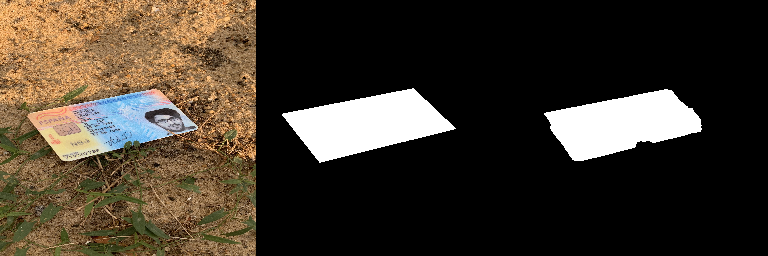

...

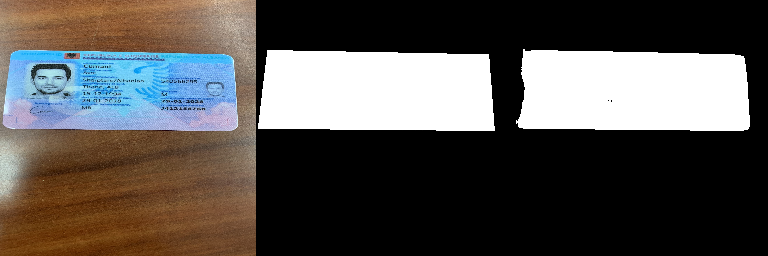

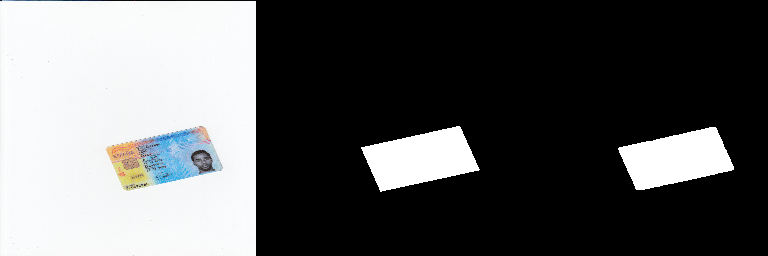

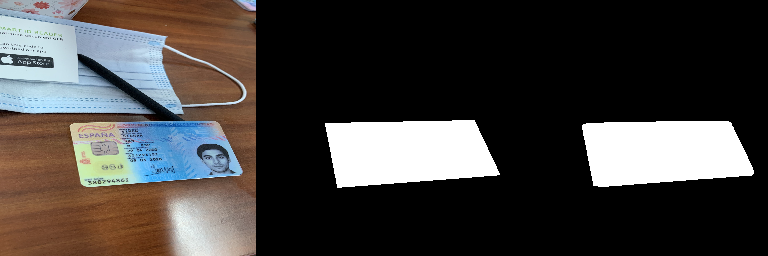

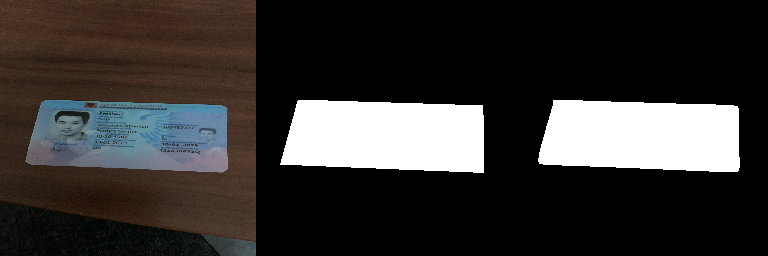

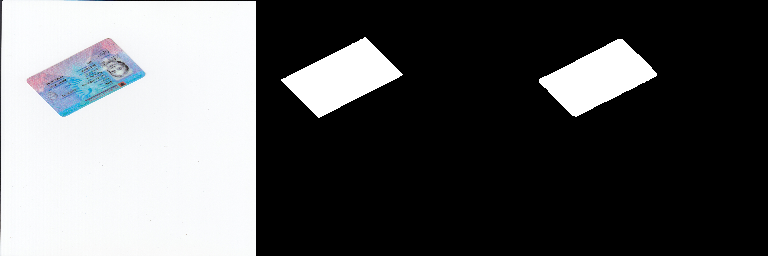

In [ ]:
# max training accuracy: 0.9981
# prediction accuracy: 0.9980
# prediction loss: 0.0039
# 160 scanned upright and 160 scanned rotated image for training
threshold_val = 0.9
ground_truth_and_predictions = pred_masks(test_dataset, test_batches, threshold_val, True)

In [ ]:
print("Evaluate on test data")
results = unet_model.evaluate(test_batches)
print("test loss, test acc:", results)

In [ ]:
is_card_threshold_val = 0.9
mean_iou_threshold_val = 0.5
ground_truth_and_predictions = pred_masks(test_dataset, test_batches, is_card_threshold_val, mean_iou_threshold_val, True)

In [ ]:
is_card_threshold_val = 0.9
mean_iou_threshold_val = 0.95
ground_truth_and_predictions = pred_masks(test_dataset, test_batches, is_card_threshold_val, mean_iou_threshold_val, True)